# 0. Preparing

## Load Modules

In [1]:
%matplotlib inline

import os
import glob
import numpy as np
from numpy.fft import fft, ifft, fftfreq
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.animation import FuncAnimation

import seaborn as sns # download  Conda 

from nltools.data import Brain_Data, Adjacency  # download pip 
from nltools.mask import expand_mask, roi_to_brain
from nltools.stats import isc, isfc, isps, fdr, threshold, phase_randomize, circle_shift, _butter_bandpass_filter, _phase_mean_angle, _phase_vector_length
from nilearn.plotting import view_img_on_surf, view_img
from sklearn.metrics import pairwise_distances
from sklearn.utils import check_random_state
from scipy.stats import ttest_1samp
from scipy.signal import hilbert
import networkx as nx
from IPython.display import HTML

# import nest_asyncio
# nest_asyncio.apply()
import datalad.api as dl #conda

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_deprecation_warnings()


In [2]:
base_dir = '/mnt/c/Users/since/Desktop/KdramaMay/'
story_dir = '/mnt/c/Users/since/Dropbox/Lab/Projects/CJY/_DATA'
data_dir = os.path.join(base_dir, 'data', 'derivatives')
denoised_dir = os.path.join(base_dir, 'analysis', 'denoised')

## Load Data

## Mask Load
ROI masking에 사용한 실제 마스크입니다.

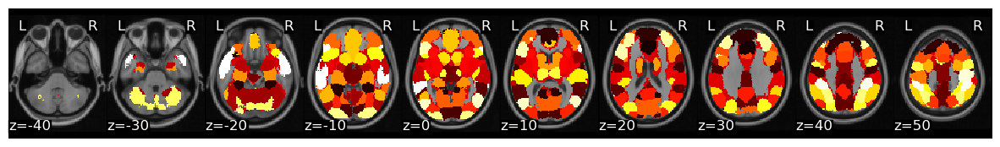

In [263]:
mask = Brain_Data('http://neurovault.org/media/images/2099/Neurosynth%20Parcellation_0.nii.gz')
mask_x = expand_mask(mask)

mask.plot()

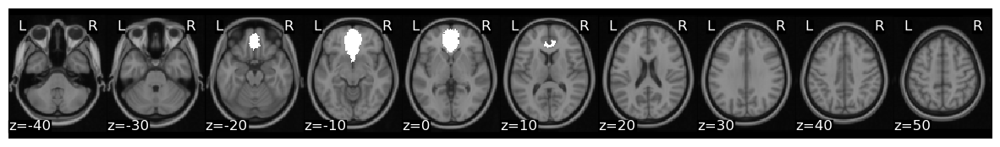

In [267]:
roi = 32
mask_x[roi].plot()

In [240]:
rois = pd.read_csv('https://raw.githubusercontent.com/naturalistic-data-analysis/tutorial_development/master/hypertools/rois.csv', header=None, names=['ID', 'Region'])
rois

,ID,Region
0,0,Anterior MPFC
1,1,Fusiform/parahippocampus
2,2,DMPFC
3,3,Sensorimotor/postcentral gyrus
4,4,V1
5,5,TPJ posterior supra marginal/angular gyrus
6,6,PCC/precuneus
7,7,Thalamus
8,8,SMA
9,9,Precentral gyrus


In [245]:
print(rois.iloc[15])

ID                                                       15
Region    TPJ anterior supra marginal gyrus/parietal ope...
Name: 15, dtype: object


## Story Sequence Load

In [271]:
# Story Sequece
# Load May Data event sequence
import scipy.io as sio
import pandas as pd

all_story = {}

subjects = ['1', '2', '3', '4', '5', '6', '7', '8', '10', '11', '12', '13', '14', '15', '16']
for sub in subjects:
    mat = sio.loadmat(glob.glob(os.path.join(story_dir, 'fMRItdsgn', 'fMRI_May', f'sub-{sub}_*.mat'))[0])
    story = []
    for i in np.arange(0,4):
        temp = mat['subj'][0][0][7][0][i][0]
        if temp == 'Blind Date':
            temp = 'BlindDate'
        elif temp == 'Runningman':
            temp = 'RunningMan'
        elif temp == 'Way To School':
            temp = 'WayToSchool'
        elif temp == 'Business Lunch':
            temp = 'BusinessLunch'
        elif temp == 'neighbors':
            temp = 'Neighbors'
        story = np.append(story, temp)
    #all_story[str(int(sub)+8)] = story
    all_story[str(int(sub))] = story

In [272]:
all_story

{'1': array(['RunningMan', 'BlindDate', 'Dream', 'Neighbors'], dtype='<U32'),
 '2': array(['Neighbors', 'Dream', 'BlindDate', 'RunningMan'], dtype='<U32'),
 '3': array(['Neighbors', 'RunningMan', 'BlindDate', 'Dream'], dtype='<U32'),
 '4': array(['BlindDate', 'Dream', 'Neighbors', 'RunningMan'], dtype='<U32'),
 '5': array(['BlindDate', 'RunningMan', 'Neighbors', 'Dream'], dtype='<U32'),
 '6': array(['Dream', 'BlindDate', 'RunningMan', 'Neighbors'], dtype='<U32'),
 '7': array(['RunningMan', 'Neighbors', 'Dream', 'BlindDate'], dtype='<U32'),
 '8': array(['Dream', 'Neighbors', 'RunningMan', 'BlindDate'], dtype='<U32'),
 '10': array(['BlindDate', 'Dream', 'Neighbors', 'RunningMan'], dtype='<U32'),
 '11': array(['RunningMan', 'BlindDate', 'Dream', 'Neighbors'], dtype='<U32'),
 '12': array(['Dream', 'BlindDate', 'RunningMan', 'Neighbors'], dtype='<U32'),
 '13': array(['Neighbors', 'Dream', 'BlindDate', 'RunningMan'], dtype='<U32'),
 '14': array(['RunningMan', 'Neighbors', 'Dream', 'BlindDate

## fRMI Data load

In [273]:
# Data Load & Trimming 

subjects = ['1', '2', '3', '4', '5', '6', '7', '8', '10', '11', '12', '13', '14', '15', '16']   # exclude sub-9. 
onset = {'set-4' :  [9, 119, 239, 359], 'set-6': [9, 129, 249, 369, 489 ], 'Dream1' : [9, 119, 239, 359], 'Dream2' : [9, 129, 239, 359], 'Dream3' : [9, 129, 249, 359], 'Dream4' : [9, 129, 249, 369]}
offset = {'set-4' : [116, 236, 356, 476], 'set-6': [126, 246, 366, 486, 606], 'Dream1' : [116, 236, 356, 476], 'Dream2' : [126, 236, 356, 476], 'Dream3' : [126, 246, 356, 476], 'Dream4' : [126, 246, 366, 476]} 
# May는 Dream의 위치에 따라 Trimming이 달라져야함.. ;D


sub_story_timeseries = {}
for sub in subjects:
    story = {} 
    sequence = np.where(all_story[str(int(sub))]=='Dream')[0][0]
    #print(sequence)
    cond = 'Dream'+str(int(sequence)+1)
    #print(cond)
    denoised_dir = os.path.join(base_dir, 'analysis', 'denoised')
    if int(sub) < 10:
        data = pd.read_csv(os.path.join(denoised_dir,'Averaged_ROI', f'sub-0{sub}_task-encoding_run-1_Average_ROI_n50.csv'))   
        data2 = pd.read_csv(os.path.join(denoised_dir,'Averaged_ROI', f'sub-0{sub}_task-encoding_run-2_Average_ROI_n50.csv')) 
    else: 
        data = pd.read_csv(os.path.join(denoised_dir,'Averaged_ROI', f'sub-{sub}_task-encoding_run-1_Average_ROI_n50.csv'))   
        data2 = pd.read_csv(os.path.join(denoised_dir,'Averaged_ROI', f'sub-{sub}_task-encoding_run-2_Average_ROI_n50.csv'))
    
    for i in np.arange(0,4):
        #print(cond)
        story[all_story[sub][i]] = {'visual' : data[onset[cond][i]:offset[cond][i]], 'audio' : data2[onset[cond][i]:offset[cond][i]]}
    
    sub_story_timeseries[str(int(sub))] = story

In [274]:
sub_story_timeseries['1']

{'RunningMan': {'visual':                 0             1             2             3             4  \
  9   -1.232786e-11 -1.280085e-11 -1.211640e-11 -1.149945e-11 -1.302320e-11   
  10  -1.141361e-11 -1.180506e-11 -1.122845e-11 -1.067354e-11 -1.201407e-11   
  11  -9.164618e-12 -9.523407e-12 -9.006691e-12 -8.537712e-12 -9.703188e-12   
  12  -6.837586e-12 -7.056269e-12 -6.714651e-12 -6.388369e-12 -7.173844e-12   
  13  -8.617149e-12 -8.963367e-12 -8.450123e-12 -7.982298e-12 -9.155596e-12   
  ..            ...           ...           ...           ...           ...   
  121  1.008430e+00 -2.367404e-02  5.830307e-01  1.015265e-01 -2.538081e+00   
  122 -1.821393e-02 -3.760203e-01  6.968165e-01 -5.275007e-01 -2.304261e-02   
  123  7.793136e-01  4.004111e-01  3.833954e-01 -4.138004e-01 -2.281477e+00   
  124  1.154034e+00 -6.610464e-01 -2.404766e-01 -3.641972e-01 -3.275253e+00   
  125  7.297186e-02 -9.447427e-01 -3.885281e-01 -6.048163e-01 -2.668656e+00   
  
                  5      

In [275]:
# Trimming Data: Kdrama May analysis 
ROIs = {}
for roi in np.arange(50):
    sub_rois = {}
    for sub in subjects:
        story_roi = {}
        for j in all_story['1']:
            story_timeseries = sub_story_timeseries[sub][j]
            run_rois = {}
            for run in ['visual', 'audio']:
                run_rois[run]  = story_timeseries[run].iloc[:, roi]
            story_roi[j] = pd.DataFrame(run_rois).reset_index(drop=True)
        sub_rois[sub] = story_roi
    ROIs[roi] = sub_rois

In [276]:
story_timeseries['visual'].shape

(117, 50)

In [277]:
ROIs[5]['1']

{'RunningMan':            visual         audio
 0   -1.260644e-11  6.281349e-12
 1   -1.163413e-11 -9.557475e-01
 2   -9.379148e-12 -1.556384e+00
 3   -6.945735e-12  4.178260e-01
 4   -8.836152e-12  3.633165e-12
 ..            ...           ...
 112  5.086581e-02  2.323641e-13
 113  5.380521e-01  4.769269e-13
 114  1.265485e+00  2.228974e-12
 115 -7.875174e-02  7.230271e-13
 116 -7.513840e-01  8.429477e-13
 
 [117 rows x 2 columns],
 'BlindDate':            visual     audio
 0    2.844574e-02  0.224721
 1   -9.493824e-01 -0.177471
 2   -4.055743e-13 -0.136107
 3   -2.168703e-12 -0.409139
 4   -1.319394e+00 -1.359191
 ..            ...       ...
 112  2.224549e-01  0.825714
 113  1.445434e-01  1.311336
 114  8.879616e-01  1.663706
 115  3.636007e-01  1.541334
 116 -9.283658e-01  1.236041
 
 [117 rows x 2 columns],
 'Dream':        visual     audio
 0   -0.492710 -1.133287
 1   -1.488690 -1.445720
 2   -0.358113 -0.707850
 3   -0.222353 -0.895002
 4   -0.933204 -0.944484
 ..        ...  

# 1. ISC for each story 

In [278]:
from tqdm import tqdm

isc_visual_r, isc_visual_p = {}, {}
isc_audio_r, isc_audio_p = {}, {}
isc_encoding_r, isc_encoding_p = {}, {}

for roi in tqdm(range(50)):
    visual_data = {}
    audio_data = {}
    data = {} 
    
    visual_stats = {}
    audio_stats = {}
    stats = {}
    
    v_story_isc_r, v_story_isc_p = {}, {}
    a_story_isc_r, a_story_isc_p = {}, {}
    story_isc_r, story_isc_p = {}, {} 
    
    # 실험 조건 별로 참가자 데이터 합치기.. 
    for j, story in enumerate(all_story['1']):
        sub_visual_data = {}
        sub_audio_data = {}
        sub_data = {}
        #print(j, story)
        for sub in subjects:
            sub_visual_data[sub] = ROIs[roi][sub][story]['visual']
            sub_audio_data[sub] = ROIs[roi][sub][story]['audio']
            sub_data[sub] = sub_visual_data[sub].append(sub_audio_data[sub])
            sub_data[sub].reset_index(inplace=True, drop=True)
        
        visual_data[j] = sub_visual_data
        audio_data[j] = sub_audio_data
        data[j] = sub_data
        
        
        # Calculating ISC
        visual_stats[j] = isc(pd.DataFrame(visual_data[j]), n_bootstraps=5000, metric='median', method='bootstrap')
        audio_stats[j] = isc(pd.DataFrame(audio_data[j]), n_bootstraps=5000, metric='median', method='bootstrap')
        stats[j] = isc(pd.DataFrame(data[j]), n_bootstraps=5000, metric='median', method='bootstrap')
        
        v_story_isc_r[j], v_story_isc_p[j] = visual_stats[j]['isc'], visual_stats[j]['p']
        a_story_isc_r[j], a_story_isc_p[j] = audio_stats[j]['isc'], audio_stats[j]['p']
        story_isc_r[j], story_isc_p[j] = stats[j]['isc'], stats[j]['p']
        
    isc_visual_r[roi], isc_visual_p[roi] = v_story_isc_r, v_story_isc_p
    isc_audio_r[roi], isc_audio_p[roi] = a_story_isc_r, a_story_isc_p
    isc_encoding_r[roi], isc_encoding_p[roi] = story_isc_r, story_isc_p

100%|███████████████████████████████████████████████████████████████████████████████████| 50/50 [05:47<00:00,  6.94s/it]


## Plotting 

In [279]:
#from nilearn import image as img
from nilearn import plotting as plot
from nilearn.plotting import view_img_on_surf, view_img

In [280]:
eISC_r, eISC_p = {}, {}
vISC_r, vISC_p = {}, {}
aISC_r, aISC_p = {}, {}
eISC_r_brain, eISC_p_brain = {}, {}
vISC_r_brain, vISC_p_brain = {}, {}
aISC_r_brain, aISC_p_brain = {}, {}

for j in tqdm(range(4)):
    eeISC_r, eeISC_p = {}, {}
    vvISC_r, vvISC_p = {}, {}
    aaISC_r, aaISC_p = {}, {}
    
    for roi in range(50):
        eeISC_r[roi], eeISC_p[roi] = isc_encoding_r[roi][j], isc_encoding_p[roi][j]
        vvISC_r[roi], vvISC_p[roi] = isc_visual_r[roi][j], isc_visual_p[roi][j]
        aaISC_r[roi], aaISC_p[roi] = isc_audio_r[roi][j], isc_audio_p[roi][j]
        
    eISC_r[j], eISC_p[j] = eeISC_r, eeISC_p
    vISC_r[j], vISC_p[j] = vvISC_r, vvISC_p
    aISC_r[j], aISC_p[j] = aaISC_r, aaISC_p
    
    eISC_r_brain[j], eISC_p_brain[j] = roi_to_brain(pd.Series(eISC_r[j]), mask_x), roi_to_brain(pd.Series(eISC_p[j]), mask_x)
    vISC_r_brain[j], vISC_p_brain[j] = roi_to_brain(pd.Series(vISC_r[j]), mask_x), roi_to_brain(pd.Series(vISC_p[j]), mask_x)
    aISC_r_brain[j], aISC_p_brain[j] = roi_to_brain(pd.Series(aISC_r[j]), mask_x), roi_to_brain(pd.Series(aISC_p[j]), mask_x)

100%|█████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.41it/s]


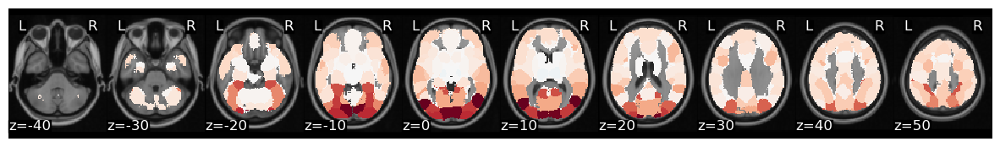

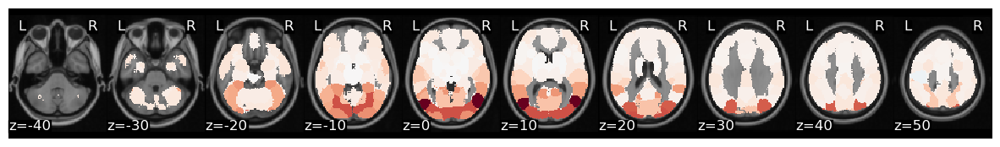

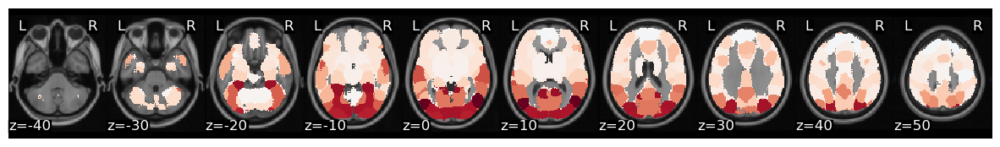

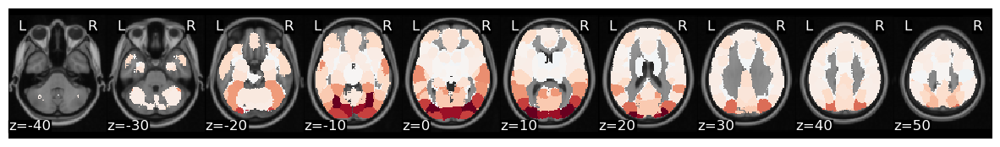

In [13]:
# vISUAL STIMULUS 
for j in range(4):
    vISC_r_brain[j].plot(cmap='RdBu_r')

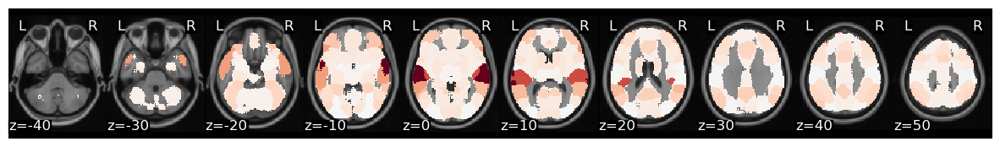

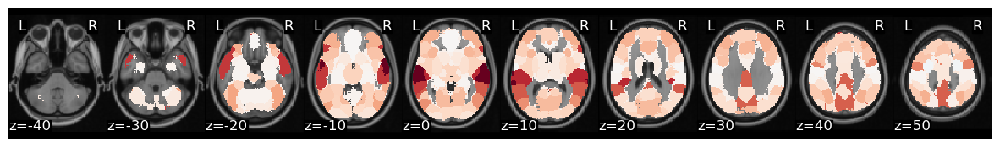

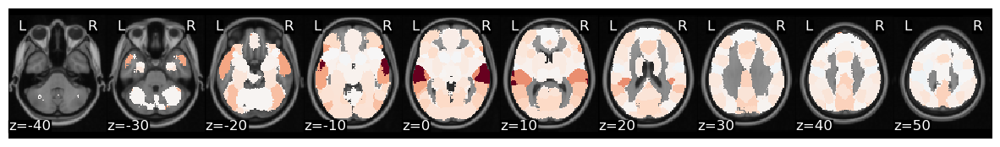

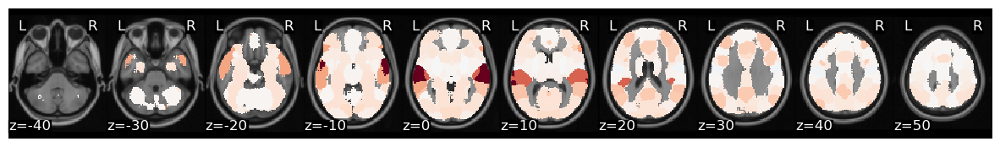

In [14]:
# AUDIO STIMULUS 
for j in range(4):
    #eISC_r_brain[j].plot(cmap='RdBu_r')
    aISC_r_brain[j].plot(cmap='RdBu_r')

In [12]:
view_img_on_surf(threshold(eISC_r_brain[1], eISC_p_brain[1], thr=.05).to_nifti())

In [281]:
def plotting_(plot, cond, story, thr):
    if cond == 'visual' :
        cond = vISC_r_brain[story]
        p = vISC_p_brain[story]
    elif cond == 'audio':  
        cond = aISC_r_brain[story]
        p = aISC_p_brain[story]
    else:
        brain_img = print('Errors in cond')
    

    if thr == 'fdr':
        thr_thr = fdr(p.data)
        if plot == 'surf':
            brain_img = view_img_on_surf(threshold(cond, p, thr_thr).to_nifti())
        elif plot == 'xyz':
            brain_img = view_img(threshold(cond, p, thr=thr_thr).to_nifti())
            
    elif thr == .001: 
        thr_thr = .001
        if plot == 'surf':
            brain_img = view_img_on_surf(threshold(cond, p, thr_thr).to_nifti())
        elif plot == 'xyz':
            brain_img = view_img(threshold(cond, p, thr=thr_thr).to_nifti())
    else: 
        if plot == 'surf': 
            brain_img = print(" put the thr value ") 
        elif plot == 'xyz' :
            brain_img = view_img(cond.to_nifti())#, draw_cross = False)
        else: 
            brain_img = print(' put the plot variable')
    return brain_img
      
    

In [282]:
all_story['1']

array(['RunningMan', 'BlindDate', 'Dream', 'Neighbors'], dtype='<U32')

In [286]:
# Plotting_style = {'surf', 'xyz'}
# Encoding_type = {'visual', 'audio'}
# Story = {0: RunningMan, 1: BlindDate, 2: Dream, 3: Neighbors}
# thr = {'fdr', '.001'} 

plotting_('surf', 'audio', 1, 'fdr')

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/masking.py:858: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)


In [284]:
def plotting_xyz(cond, story, thr):
    
    if cond == 'visual' :
        cond = vISC_r_brain[story]
        p = vISC_p_brain[story]
    elif cond == 'audio':  
        cond = aISC_r_brain[story]
        p = aISC_p_brain[story]
    else:
        print('Errors in cond')
    if thr == 'fdr':
        thr_thr = fdr(p.data)
        brain_img = view_img(threshold(cond, p, thr=thr_thr).to_nifti())
    elif thr == .001: 
        thr_thr = .001
        brain_img = view_img(threshold(cond, p, thr=thr_thr).to_nifti())
    else: 
        brain_img = view_img(cond.to_nifti())#, draw_cross = False)
    return brain_img
    

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/masking.py:858: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/plotting/html_document.py:63: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



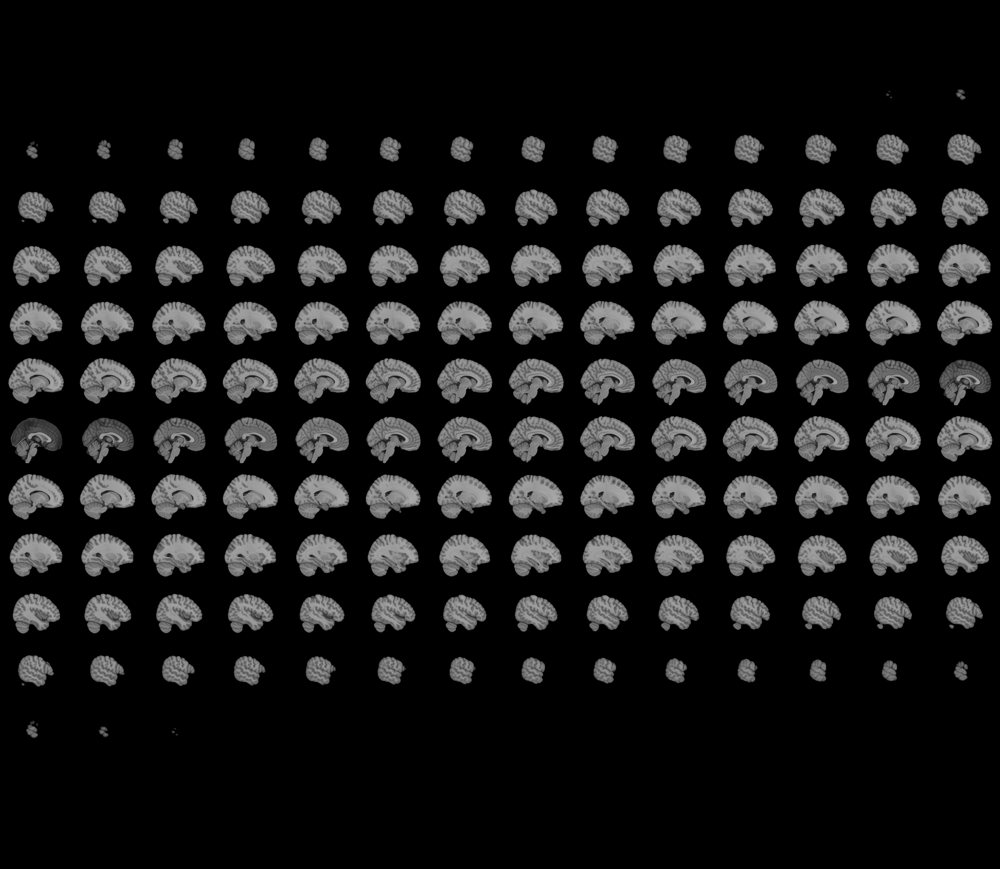
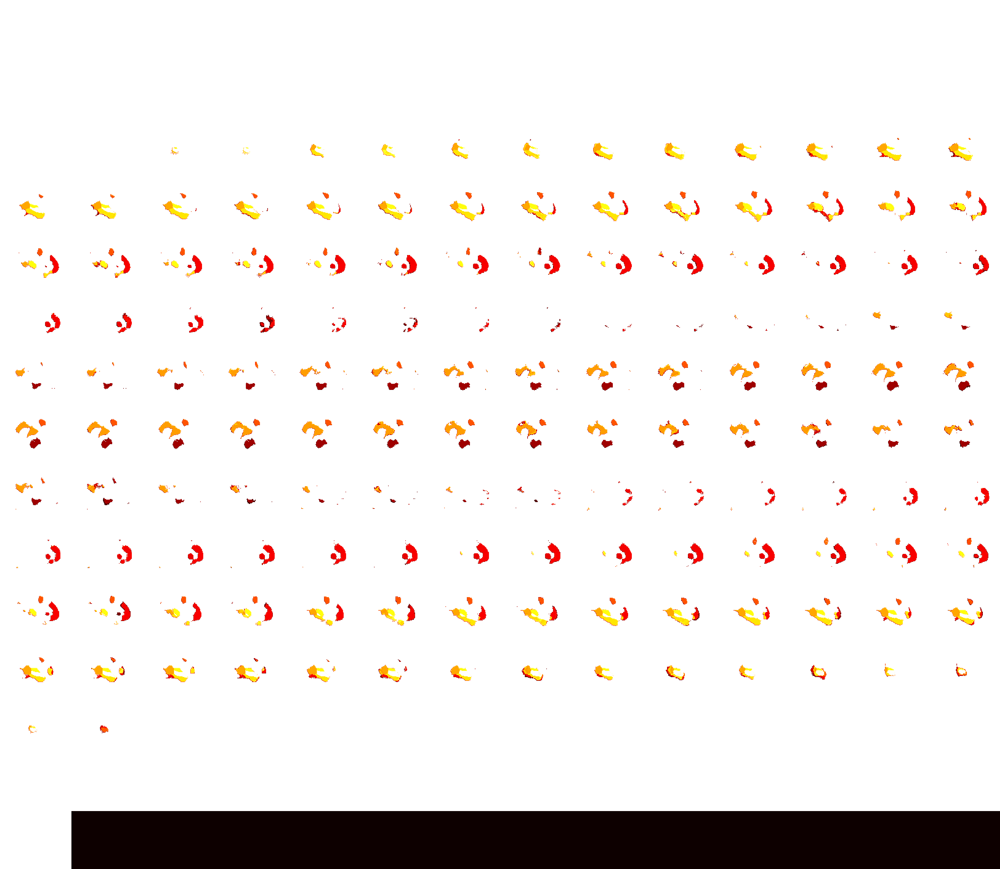

In [290]:
# Encoding_type = {'visual', 'audio'}
# Story = {0: RunningMan, 1: BlindDate, 2: Dream, 3: Neighbors}
# thr = {'fdr', '.001'} 

plotting_xyz('audio', 1, 'fdr') # 

# 2. ISC & ISFC for Compare audio vs visual

In [291]:
visual_story = {}
audio_story = {}
for j,story in enumerate(all_story['1']):
    v_sub_timeseries= {}
    a_sub_timeseries = {}
    for sub in subjects:
        v_sub_timeseries[sub] =  sub_story_timeseries[sub][story]['visual'].reset_index(drop = True)
        a_sub_timeseries[sub] = sub_story_timeseries[sub][story]['audio'].reset_index(drop = True)
        
    visual_story[j] = list(v_sub_timeseries.values())
    audio_story[j] = list(a_sub_timeseries.values())

In [292]:
print('Number of subj: %s' %len(subjects))
print(all_story['1'])

Number of subj: 15
['RunningMan' 'BlindDate' 'Dream' 'Neighbors']


In [293]:
# 1번 참가자의 이야기 순서대로 모든 참가자들의 데이터 정렬 
a_sub_timeseries = {}
v_sub_timeseries = {}
for sub in subjects:   
    a_sub_data = sub_story_timeseries[sub][all_story['1'][0]]['audio']
    v_sub_data = sub_story_timeseries[sub][all_story['1'][0]]['visual']
    for j in all_story['1']: 
        a_sub_data = a_sub_data.append(sub_story_timeseries[sub][j]['audio'])
        v_sub_data = v_sub_data.append(sub_story_timeseries[sub][j]['visual'])
    a_sub_data.reset_index(inplace=True, drop=True)
    v_sub_data.reset_index(inplace=True, drop=True)
    a_sub_timeseries[sub] = a_sub_data
    v_sub_timeseries[sub] = v_sub_data

In [294]:
ROIs = {}
for roi in np.arange(50):
    a_sub_rois = {}
    v_sub_rois = {}
    for sub in subjects:
        a_sub_rois[sub] = a_sub_timeseries[sub].iloc[:, roi]
        v_sub_rois[sub] = v_sub_timeseries[sub].iloc[:, roi]
    ROIs[roi] = {'visual': pd.DataFrame(a_sub_rois), 'audio': pd.DataFrame(v_sub_rois)}

## ISC

In [295]:
all_audio_isc_r, all_audio_isc_p = {}, {}
all_visual_isc_r, all_visual_isc_p = {}, {}
for roi in range(50):
    all_a_stats = isc(ROIs[roi]['audio'], n_bootstraps=5000, metric='median', method='bootstrap')
    all_v_stats = isc(ROIs[roi]['visual'], n_bootstraps=5000, metric='median', method='bootstrap')
    
    all_audio_isc_r[roi], all_audio_isc_p[roi] = all_a_stats['isc'], all_a_stats['p']
    all_visual_isc_r[roi], all_visual_isc_p[roi] = all_v_stats['isc'], all_v_stats['p']
    
all_a_isc_r_brain, all_a_isc_p_brain = roi_to_brain(pd.Series(all_audio_isc_r), mask_x), roi_to_brain(pd.Series(all_audio_isc_p), mask_x)
all_v_isc_r_brain, all_v_isc_p_brain = roi_to_brain(pd.Series(all_visual_isc_r), mask_x), roi_to_brain(pd.Series(all_visual_isc_p), mask_x)

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_deprecation_warnings()
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_deprecation_warnings()
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_deprecation_warnings()
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_dep

### Plotting ISC

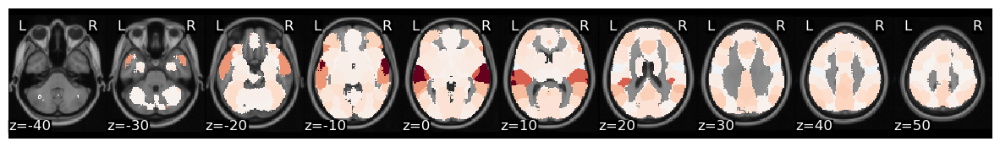

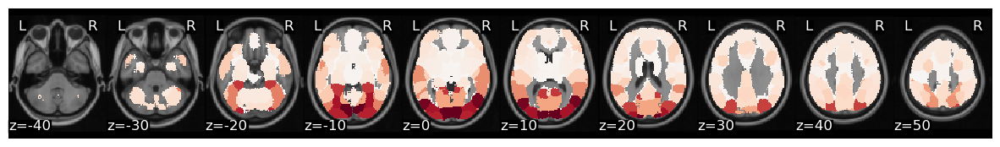

In [141]:
all_v_isc_r_brain.plot(cmap='RdBu_r')
all_a_isc_r_brain.plot(cmap='RdBu_r')

In [142]:
def plotting_for_all_stories(plot, cond, thr):
    if cond == 'visual' :
        cond = all_v_isc_r_brain
        p = all_v_isc_p_brain
    elif cond == 'audio':  
        cond = all_a_isc_r_brain
        p = all_a_isc_p_brain
    else:
        brain_img = print('Errors in cond')
    

    if thr == 'fdr':
        thr_thr = fdr(p.data)
        if plot == 'surf':
            brain_img = view_img_on_surf(threshold(cond, p, thr_thr).to_nifti())
        elif plot == 'xyz':
            brain_img = view_img(threshold(cond, p, thr=thr_thr).to_nifti())
            
    elif thr == .001: 
        thr_thr = .001
        if plot == 'surf':
            brain_img = view_img_on_surf(threshold(cond, p, thr_thr).to_nifti())
        elif plot == 'xyz':
            brain_img = view_img(threshold(cond, p, thr=thr_thr).to_nifti())
    else: 
        if plot == 'surf': 
            brain_img = print(" put the thr value ") 
        elif plot == 'xyz' :
            brain_img = view_img(cond.to_nifti())
        else: 
            brain_img = print(' put the plot variable')
    return brain_img

/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/masking.py:858: UserWarning: Data array used to create a new image contains 64-bit ints. This is likely due to creating the array with numpy and passing `int` as the `dtype`. Many tools such as FSL and SPM cannot deal with int64 in Nifti images, so for compatibility the data has been converted to int32.
  return new_img_like(mask_img, unmasked, affine)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/plotting/html_document.py:63: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



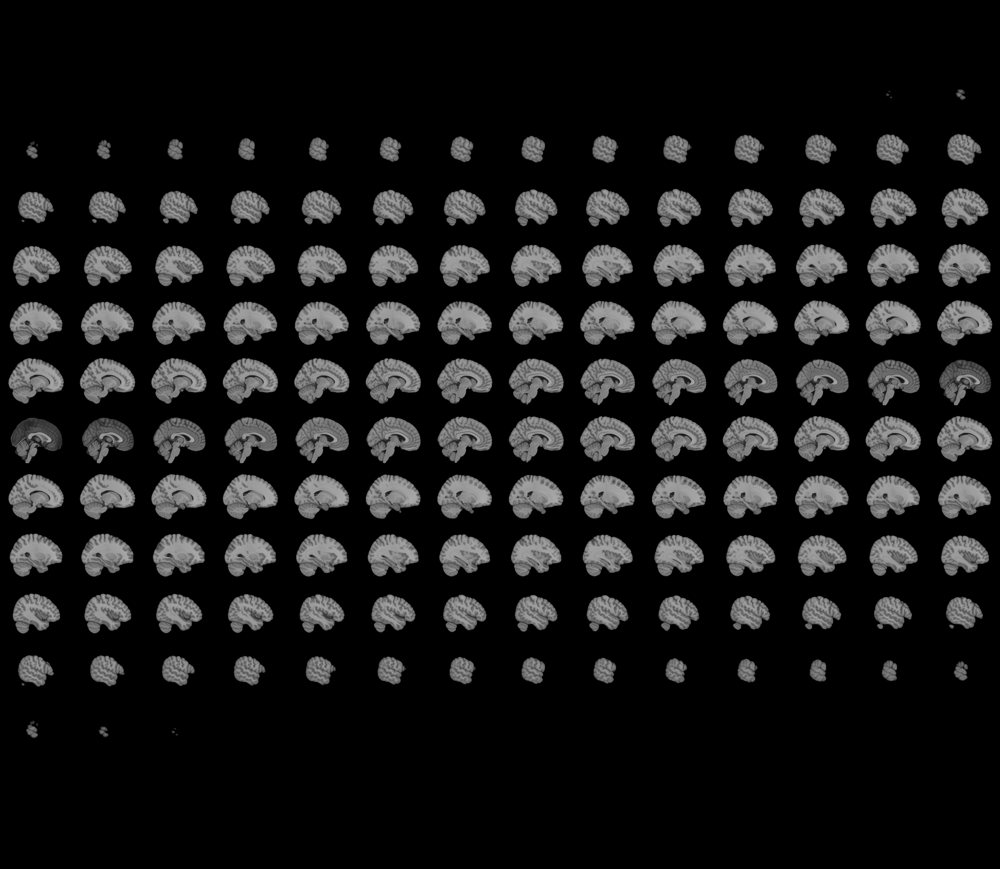
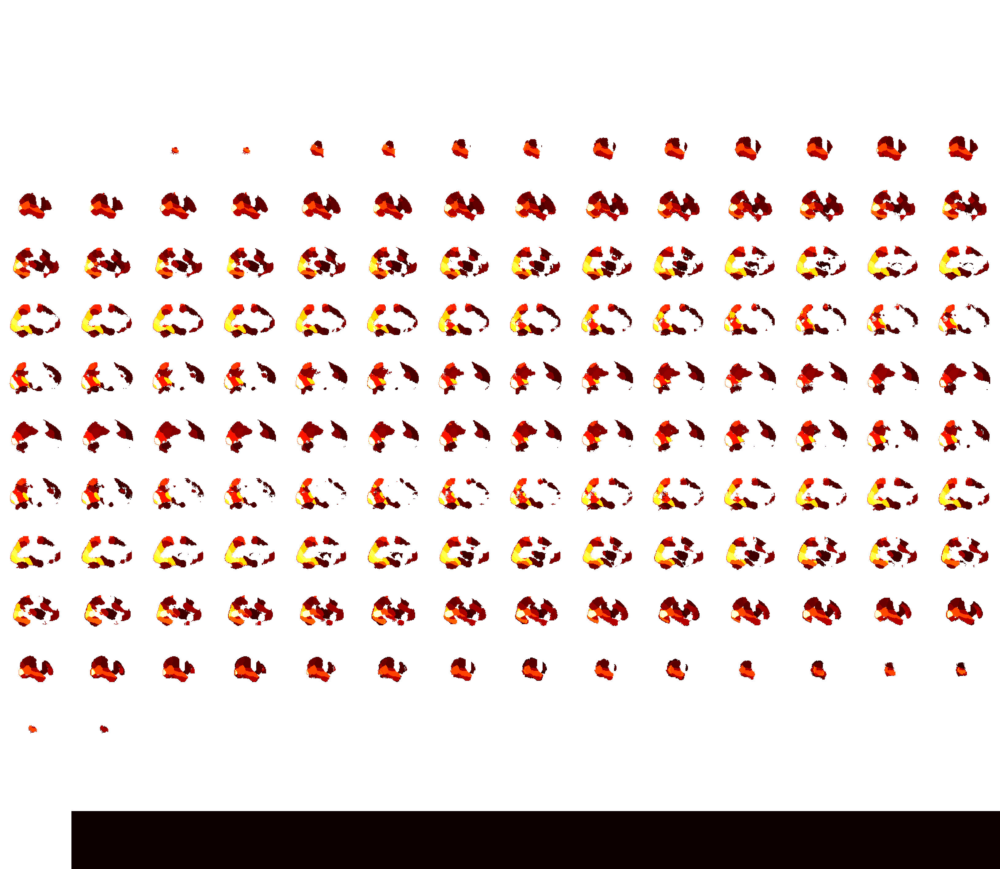

In [148]:
# plot : 'surf', 'xyz'
# cond : 'audio','visual'
# thr : 'fdr', .001
plotting_for_all_stories('xyz', 'audio', 'fdr')

## ISFC

Text(816.0353535353534, 0.5, 'ROI')

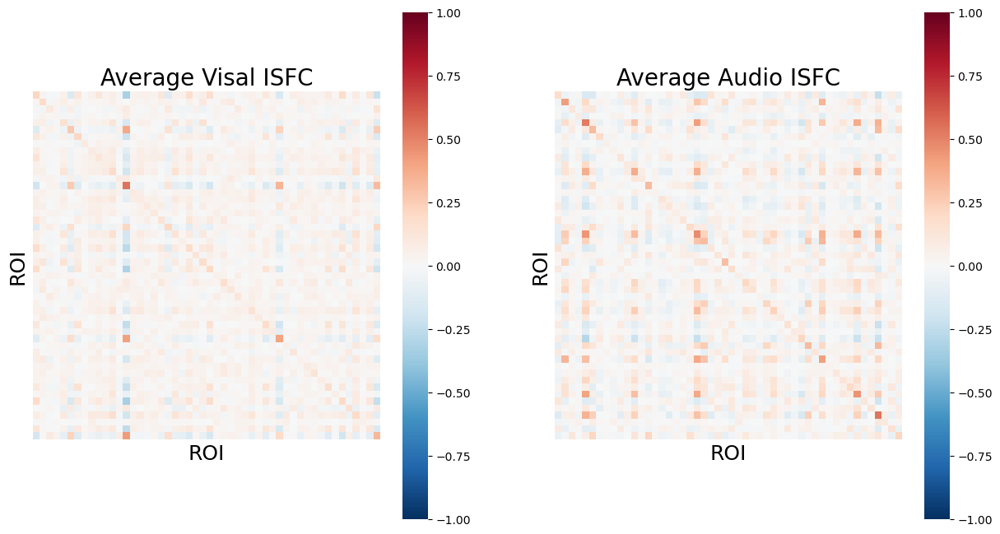

In [149]:
data = list(a_sub_timeseries.values())
data2 = list(v_sub_timeseries.values())


audio_isfc_output = isfc(data)
visual_isfc_output = isfc(data2)

plt.figure(figsize=(15,8))
plt.subplot(1, 2, 1)
sns.heatmap(np.array(audio_isfc_output).mean(axis=0), vmin=-1, vmax=1, square=True, cmap='RdBu_r', xticklabels=False, yticklabels=False)
plt.title('Average Visal ISFC', fontsize=20)
plt.xlabel('ROI', fontsize=18)
plt.ylabel('ROI', fontsize=18)

plt.subplot(1, 2, 2)
sns.heatmap(np.array(visual_isfc_output).mean(axis=0), vmin=-1, vmax=1, square=True, cmap='RdBu_r', xticklabels=False, yticklabels=False)
plt.title('Average Audio ISFC', fontsize=20)
plt.xlabel('ROI', fontsize=18)
plt.ylabel('ROI', fontsize=18)

Text(816.0353535353534, 0.5, 'ROI')

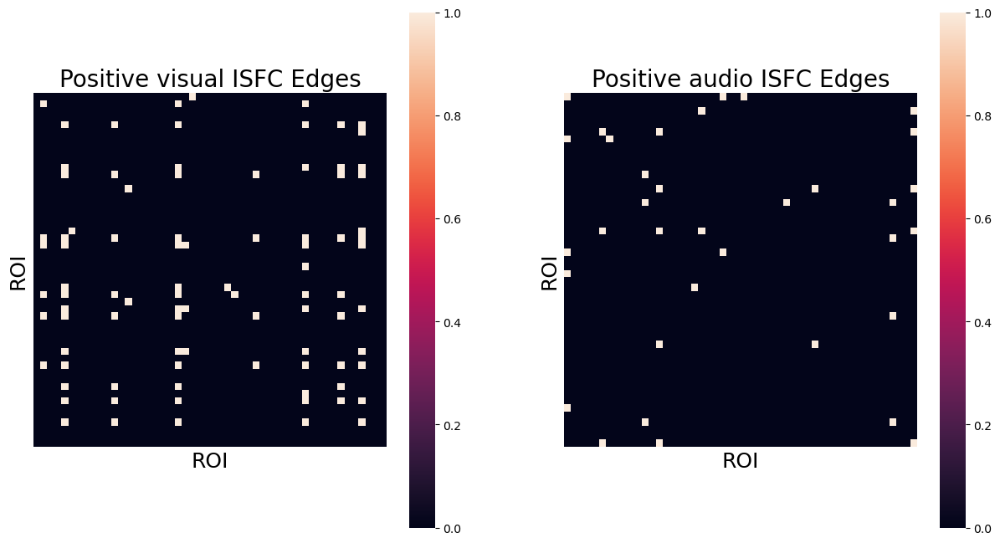

In [258]:
v_t, v_p = ttest_1samp(np.array([x.reshape(-1) for x in visual_isfc_output]), 0)
thresh = fdr(v_p, .00001)
thresholded_t_pos = v_t.copy()
thresholded_t_pos[v_p > thresh] = 0
thresholded_t_pos[thresholded_t_pos <= 0] = 0
thresholded_t_pos[thresholded_t_pos > 0] = 1
thresholded_t_pos = np.reshape(thresholded_t_pos, visual_isfc_output[0].shape)

a_t, a_p = ttest_1samp(np.array([x.reshape(-1) for x in audio_isfc_output]), 0)
thresh = fdr(a_p, .00001)
thresholded_t_pos2 = a_t.copy()
thresholded_t_pos2[a_p > thresh] = 0
thresholded_t_pos2[thresholded_t_pos2 <= 0] = 0
thresholded_t_pos2[thresholded_t_pos2 > 0] = 1
thresholded_t_pos2 = np.reshape(thresholded_t_pos2, audio_isfc_output[0].shape)

plt.figure(figsize=(15,8))
plt.subplot(1, 2, 1)
sns.heatmap(thresholded_t_pos, square=True, xticklabels=False, yticklabels=False)
plt.title('Positive visual ISFC Edges', fontsize=20)
plt.xlabel('ROI', fontsize=18)
plt.ylabel('ROI', fontsize=18)

plt.subplot(1, 2, 2)
sns.heatmap(thresholded_t_pos2, square=True, xticklabels=False, yticklabels=False)
plt.title('Positive audio ISFC Edges', fontsize=20)
plt.xlabel('ROI', fontsize=18)
plt.ylabel('ROI', fontsize=18)

### Plotting ISFC

Reference sites 
- 네트워크 파라미터 설정: https://networkx.org/documentation/stable/reference/drawing.html#module-networkx.drawing.layout
- 네트워크 형태 설정: https://brain-nim.tistory.com/61

Graph with 50 nodes and 36 edges
Graph with 50 nodes and 13 edges


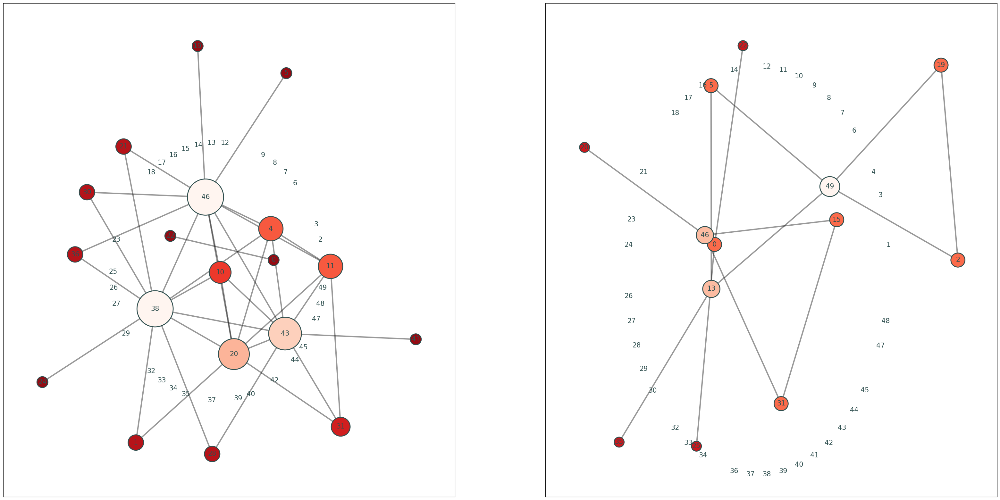

In [261]:
plt.figure(figsize=(40,20))
plt.subplot(1, 2, 1)
G = Adjacency(thresholded_t_pos, matrix_type='similarity').to_graph()
print(G)
#pos = nx.spring_layout(G)
#pos = nx.shell_layout(G)
pos = nx.kamada_kawai_layout(G)

node_and_degree = G.degree()
#print(node_and_degree)
nx.draw_networkx_edges(G, pos, width=3, alpha=.4)

nx.draw_networkx_labels(G, pos, font_size=15, font_color='darkslategray')
nx.draw_networkx_nodes(G, pos, nodelist=list(dict(node_and_degree).keys()),
                       node_size=[x[1]* 600 for x in node_and_degree],
                       node_color=list(dict(node_and_degree).values()),
                       cmap=plt.cm.Reds_r, linewidths=2, edgecolors='darkslategray', alpha=1)

plt.subplot(1, 2, 2)
G = Adjacency(thresholded_t_pos2, matrix_type='similarity').to_graph()
print(G)
#pos = nx.spring_layout(G)
#pos = nx.shell_layout(G)
pos = nx.kamada_kawai_layout(G)


node_and_degree = G.degree()
#print(node_and_degree)
nx.draw_networkx_edges(G, pos, width=3, alpha=.4)
nx.draw_networkx_labels(G, pos, font_size=15, font_color='darkslategray')

nx.draw_networkx_nodes(G, pos, nodelist=list(dict(node_and_degree).keys()),
                       node_size=[x[1]* 500 for x in node_and_degree],
                       node_color=list(dict(node_and_degree).values()),
                       cmap=plt.cm.Reds_r, linewidths=2, edgecolors='darkslategray', alpha=1)



 Brain Image for VISUAL encoding


/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/plotting/html_document.py:63: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



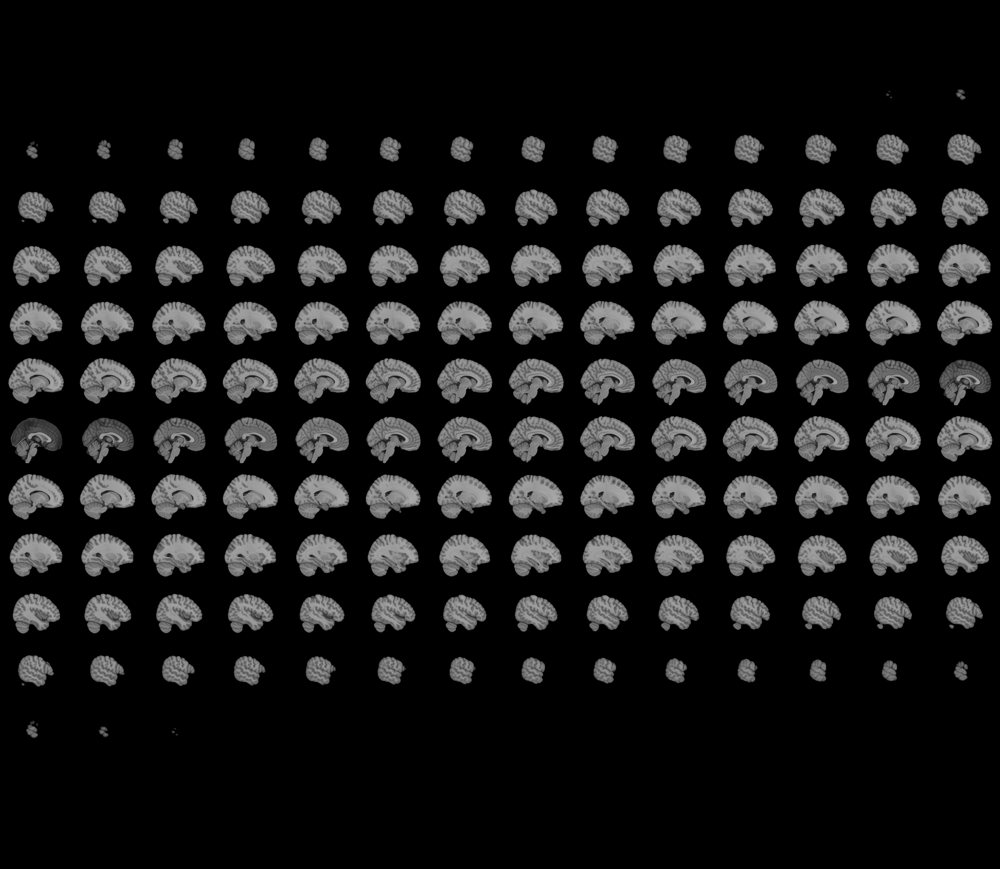
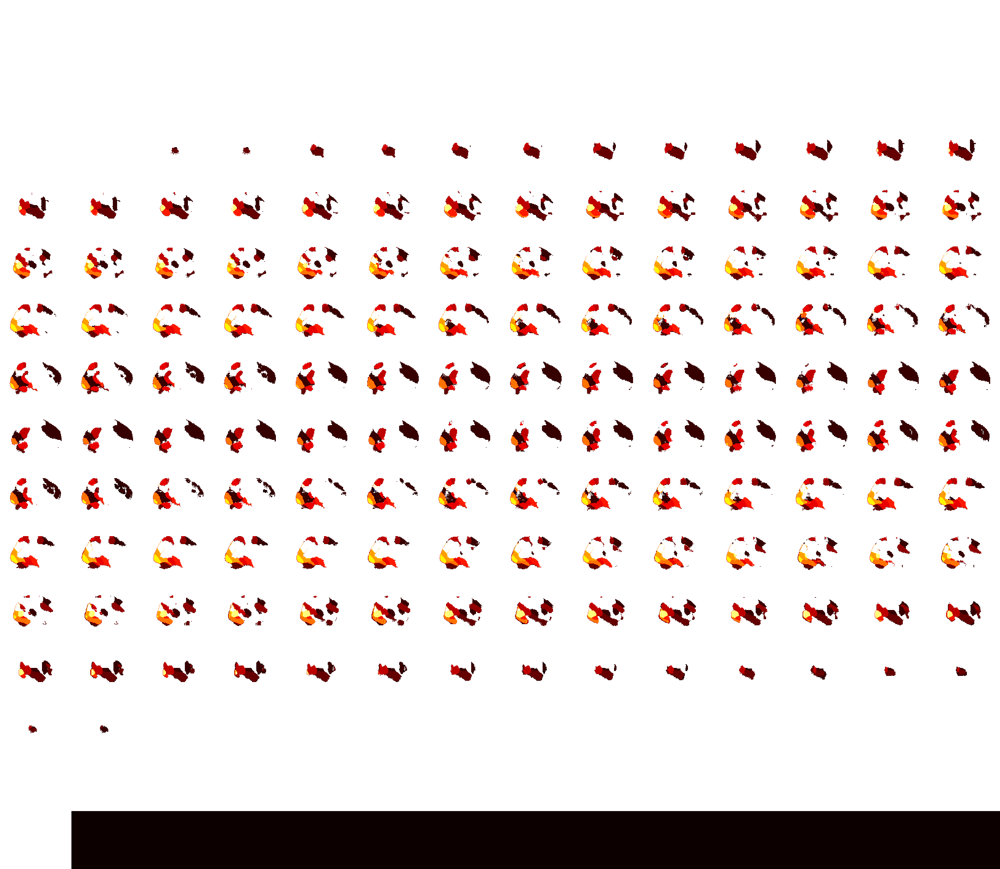

In [222]:
print(' Brain Image for VISUAL encoding')

degree = pd.Series(dict(Adjacency(thresholded_t_pos, matrix_type='similarity').to_graph().degree()))
brain_degree = roi_to_brain(degree, mask_x)
#brain_degree.plot()

#view_img_on_surf(brain_degree.to_nifti())
view_img(brain_degree.to_nifti())

 Brain Image for AUDIO encoding


/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)
/home/sincerely/.conda/envs/ISC/lib/python3.7/site-packages/nilearn/plotting/html_document.py:63: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))



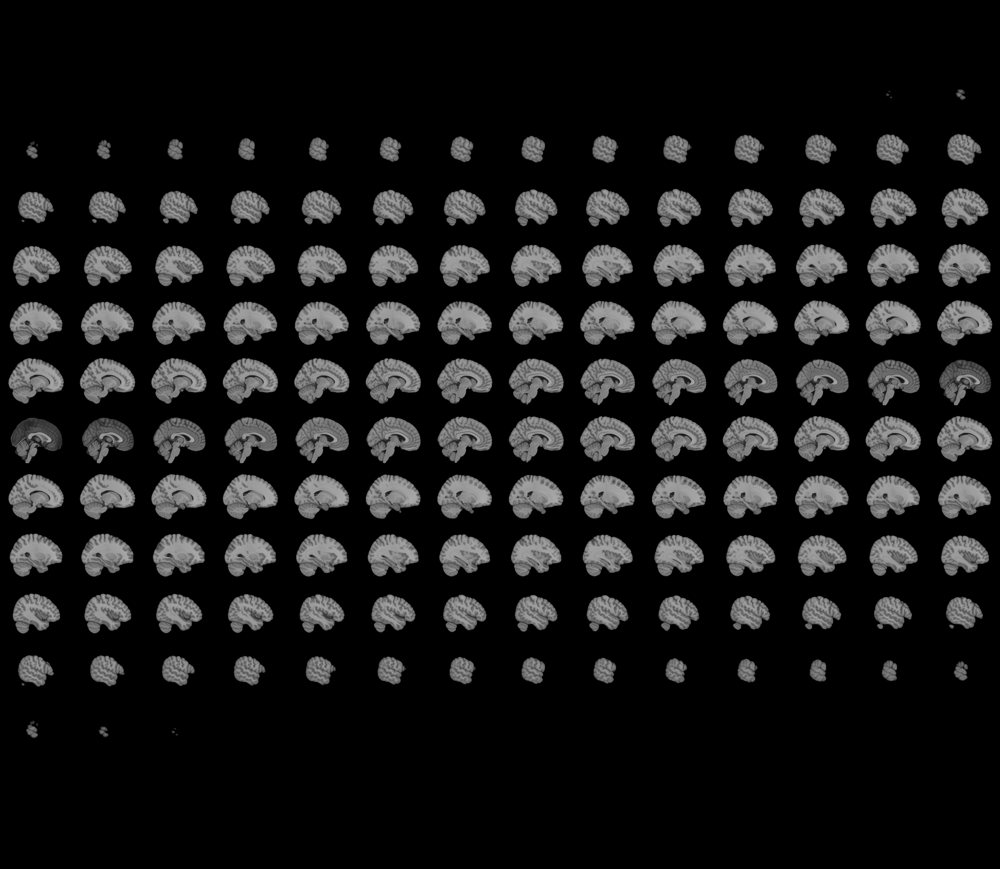
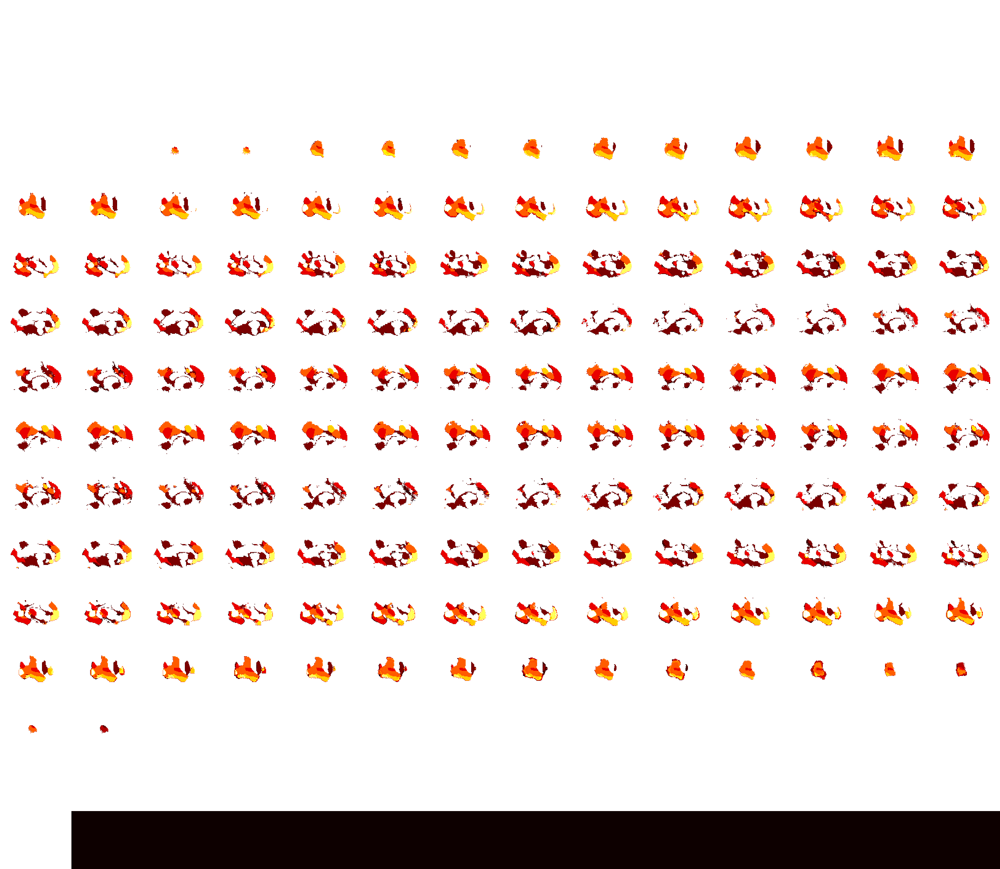

In [221]:
print(' Brain Image for AUDIO encoding')
degree = pd.Series(dict(Adjacency(thresholded_t_pos2, matrix_type='similarity').to_graph().degree()))
brain_degree = roi_to_brain(degree, mask_x)
#brain_degree.plot()

#view_img_on_surf(brain_degree.to_nifti())
view_img(brain_degree.to_nifti())